In [40]:
# =========================
# Global configuration
# =========================

CONFIG = {
    "sr": 44100,
    "n_fft": 2048,
    "hop_ratio": 4,
    "freq_neighborhood": 20,
    "time_neighborhood": 20,
    "amplitude_threshold": -35,
    "num_bands": 6,
    "fanout": 10,
    "dt_min": 2,
    "dt_max_seconds": 2.0,
}


In [41]:
from google.colab import files

uploaded = files.upload()


Saving 5 Seconds of Summer - Wildflower (Official Video).mp3 to 5 Seconds of Summer - Wildflower (Official Video) (1).mp3


In [42]:
import librosa
import IPython.display as ipd
audio_path = list(uploaded.keys())[0]

y,sr = librosa.load(audio_path,sr=None,mono=True)
print("Sampling rate:", sr)
print("Duration (seconds):", len(y) / sr)
ipd.Audio(data=y, rate=sr)

Sampling rate: 44100
Duration (seconds): 228.5772335600907


In [43]:
import numpy as np
import librosa.display
import matplotlib.pyplot as plt


In [44]:
analysis_start_sec = 124
analysis_duration_sec = 10

start = int(analysis_start_sec * sr)
end = int((analysis_start_sec + analysis_duration_sec) * sr)
y_seg = y[start:end]

print("Analysis segment length (sec):", len(y_seg) / sr)

Analysis segment length (sec): 10.0


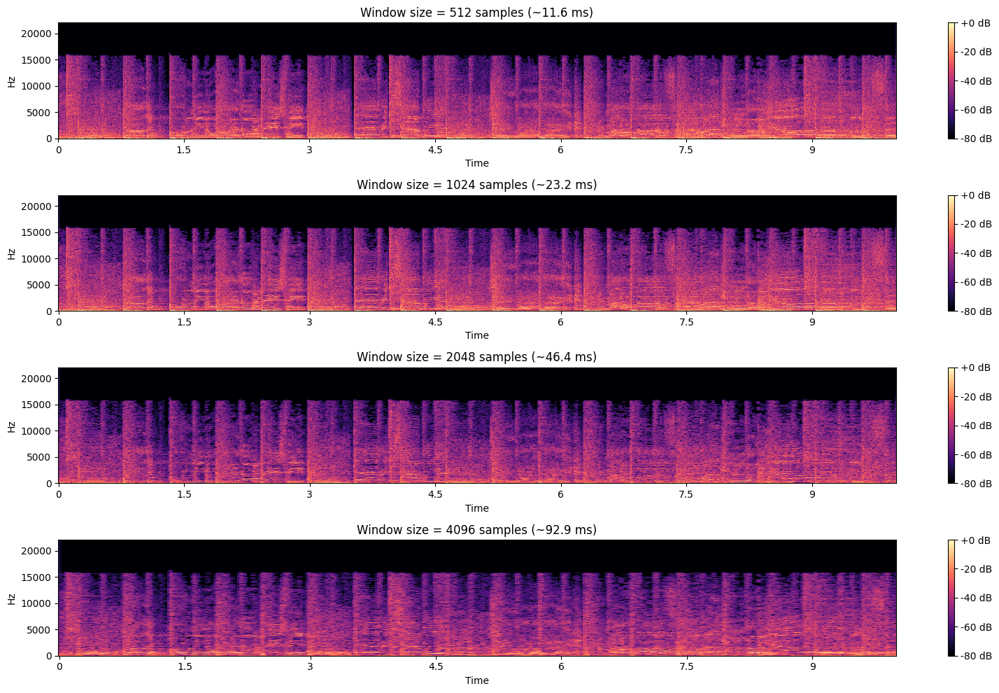

In [45]:
import numpy as np
import librosa.display
import matplotlib.pyplot as plt

window_sizes = [512, 1024, 2048, 4096]
hop_ratio = 4

plt.figure(figsize=(16, 10))

for i, n_fft in enumerate(window_sizes):
    hop_length = n_fft // hop_ratio

    S = np.abs(librosa.stft(
        y_seg,
        n_fft=n_fft,
        hop_length=hop_length
    ))
    S_db = librosa.amplitude_to_db(S, ref=np.max)

    plt.subplot(len(window_sizes), 1, i + 1)
    librosa.display.specshow(
        S_db,
        sr=sr,
        hop_length=hop_length,
        x_axis="time",
        y_axis="hz"
    )
    plt.title(f"Window size = {n_fft} samples (~{n_fft/sr*1000:.1f} ms)")
    plt.colorbar(format="%+2.0f dB")

plt.tight_layout()
plt.show()


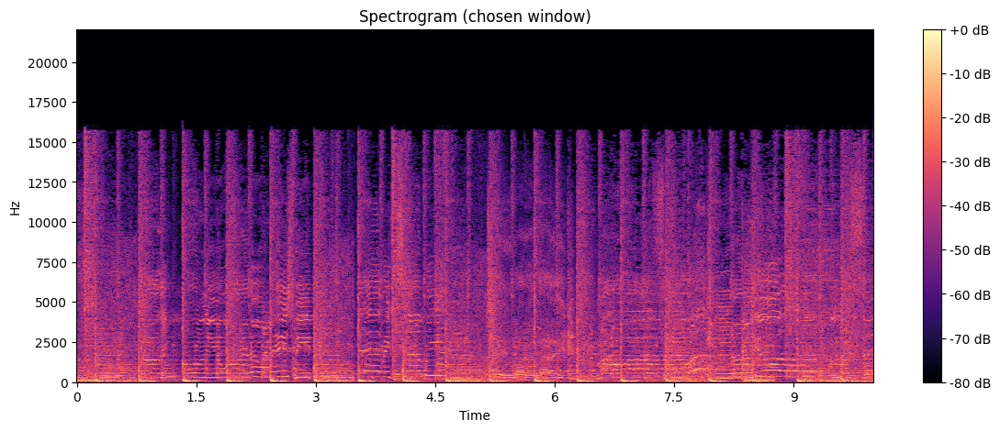

In [46]:
n_fft = 2048
hop_length = n_fft // 4

S = np.abs(librosa.stft(
    y_seg,
    n_fft=n_fft,
    hop_length=hop_length
))
S_db = librosa.amplitude_to_db(S, ref=np.max)

plt.figure(figsize=(14, 5))
librosa.display.specshow(
    S_db,
    sr=sr,
    hop_length=hop_length,
    x_axis="time",
    y_axis="hz"
)
plt.colorbar(format="%+2.0f dB")
plt.title("Spectrogram (chosen window)")
plt.show()


In [47]:
from scipy.ndimage import maximum_filter

# Neighborhood definition
freq_neighborhood = 20
time_neighborhood = 20
# Amplitude threshold
amplitude_threshold = -35  # dB

# Local maxima
local_max = maximum_filter(
    S_db,
    size=(freq_neighborhood, time_neighborhood)
)
num_bands = 6
peaks = np.zeros_like(S_db, dtype=bool)

freq_bins = S_db.shape[0]
band_size = freq_bins // num_bands

for b in range(num_bands):
    f_start = b * band_size
    f_end = freq_bins if b == num_bands - 1 else (b + 1) * band_size

    band = S_db[f_start:f_end, :]

    band_local_max = maximum_filter(
        band,
        size=(freq_neighborhood, time_neighborhood)
    )

    band_peaks = (band == band_local_max) & (band > amplitude_threshold)
    peaks[f_start:f_end, :] |= band_peaks


freq_idx, time_idx = np.where(peaks)


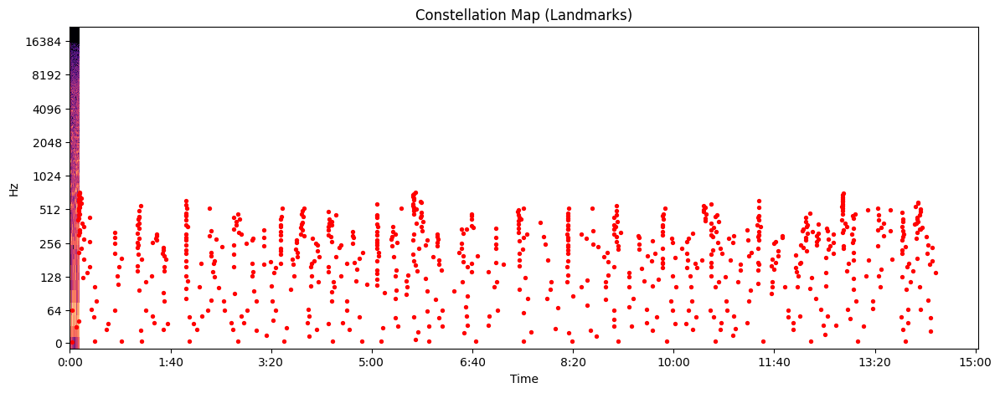

Number of landmarks detected: 791


In [48]:
plt.figure(figsize=(14, 5))
librosa.display.specshow(
    S_db,
    sr=sr,
    hop_length=hop_length,
    x_axis="time",
    y_axis="log"
)
plt.scatter(
    time_idx,
    freq_idx,
    s=8,
    c="red"
)
plt.title("Constellation Map (Landmarks)")
plt.show()

print("Number of landmarks detected:", len(freq_idx))


In [49]:
peaks = [(int(time), int(freq)) for time, freq in zip(time_idx, freq_idx)]
print(peaks)

[(2, 2), (25, 3), (51, 3), (71, 3), (119, 3), (167, 3), (213, 3), (261, 3), (290, 3), (309, 3), (357, 3), (403, 3), (451, 3), (499, 3), (545, 3), (593, 3), (641, 3), (689, 3), (736, 3), (783, 3), (830, 3), (343, 7), (238, 13), (523, 13), (659, 14), (195, 15), (750, 17), (392, 19), (496, 19), (458, 21), (346, 22), (855, 23), (70, 25), (185, 25), (517, 25), (579, 25), (36, 26), (93, 26), (126, 26), (162, 26), (245, 26), (278, 26), (619, 26), (646, 26), (719, 26), (828, 26), (661, 27), (482, 28), (215, 30), (311, 30), (6, 31), (326, 32), (370, 32), (789, 32), (357, 33), (541, 33), (558, 33), (395, 34), (416, 34), (749, 34), (761, 34), (38, 38), (97, 38), (123, 38), (257, 38), (601, 38), (612, 38), (84, 39), (160, 39), (173, 39), (236, 39), (271, 39), (573, 39), (647, 39), (673, 39), (719, 39), (833, 39), (9, 43), (202, 44), (541, 46), (775, 48), (323, 49), (367, 49), (855, 49), (342, 50), (24, 51), (119, 51), (288, 51), (583, 51), (622, 51), (640, 51), (714, 51), (826, 51), (82, 52), (131

In [50]:
peaks.sort(key=lambda x: x[0])

print("First 10 peaks:", peaks[:10])

First 10 peaks: [(2, 2), (2, 64), (6, 31), (8, 408), (9, 43), (9, 209), (9, 301), (9, 423), (9, 453), (9, 494)]


In [51]:
peaks.sort(key=lambda x: x[0])

fanout = 10
dt_min = 2
dt_max = int(2.0 * sr / hop_length)

fingerprints = []

num_peaks = len(peaks)

for i in range(num_peaks):
    t1, f1 = peaks[i]
    targets_added = 0

    for j in range(i + 1, num_peaks):
        t2, f2 = peaks[j]
        dt = t2 - t1

        if dt < dt_min:
            continue

        if dt > dt_max:
            break

        fingerprints.append((f1, f2, dt, t1))
        targets_added += 1

        if targets_added >= fanout:
            break

print("Number of fingerprints:", len(fingerprints))

for fp in fingerprints[:10]:
    print(fp)


Number of fingerprints: 7845
(2, 31, 4, 2)
(2, 408, 6, 2)
(2, 43, 7, 2)
(2, 209, 7, 2)
(2, 301, 7, 2)
(2, 423, 7, 2)
(2, 453, 7, 2)
(2, 494, 7, 2)
(2, 521, 7, 2)
(2, 597, 7, 2)


In [52]:
def make_hash(f1, f2, dt):
    return (f1, f2, dt)


In [53]:
from collections import defaultdict

db = defaultdict(list)

for f1, f2, dt, t1 in fingerprints:
    h = make_hash(f1, f2, dt)
    db[h].append(t1)

print("Number of unique hashes in DB:", len(db))


Number of unique hashes in DB: 7754


In [54]:
query_start_sec = 60
query_duration_sec = 6

qs = int(query_start_sec * sr)
qe = int((query_start_sec + query_duration_sec) * sr)

y_query = y[qs:qe]


In [55]:
S_q = np.abs(librosa.stft(
    y_query,
    n_fft=n_fft,
    hop_length=hop_length
))
S_q_db = librosa.amplitude_to_db(S_q, ref=np.max)


In [56]:
from scipy.ndimage import maximum_filter

freq_neighborhood = 20
time_neighborhood = 20
amplitude_threshold = -35
num_bands = 6

peaks_q = np.zeros_like(S_q_db, dtype=bool)

freq_bins = S_q_db.shape[0]
band_size = freq_bins // num_bands

for b in range(num_bands):
    f_start = b * band_size
    f_end = freq_bins if b == num_bands - 1 else (b + 1) * band_size

    band = S_q_db[f_start:f_end, :]
    band_local_max = maximum_filter(
        band,
        size=(freq_neighborhood, time_neighborhood)
    )

    band_peaks = (band == band_local_max) & (band > amplitude_threshold)
    peaks_q[f_start:f_end, :] |= band_peaks

freq_idx_q, time_idx_q = np.where(peaks_q)
peaks_q_list = list(zip(time_idx_q, freq_idx_q))
peaks_q_list.sort(key=lambda x: x[0])


In [57]:
fanout = 10
dt_min = 2
dt_max = int(2.0 * sr / hop_length)

query_fingerprints = []

for i in range(len(peaks_q_list)):
    t1, f1 = peaks_q_list[i]
    count = 0

    for j in range(i + 1, len(peaks_q_list)):
        t2, f2 = peaks_q_list[j]
        dt = t2 - t1

        if dt < dt_min:
            continue
        if dt > dt_max:
            break

        query_fingerprints.append((f1, f2, dt, t1))
        count += 1

        if count >= fanout:
            break


In [58]:
offset_votes = defaultdict(int)

for f1, f2, dt, t_query in query_fingerprints:
    h = make_hash(f1, f2, dt)

    if h in db:
        for t_db in db[h]:
            offset = t_db - t_query
            offset_votes[offset] += 1


In [59]:
best_offset = max(offset_votes, key=offset_votes.get)
best_score = offset_votes[best_offset]

print("Best offset (frames):", best_offset)
print("Votes:", best_score)


Best offset (frames): 558
Votes: 154


MODULARIZATION OF NB


In [60]:
def extract_fingerprints(y):
    S = np.abs(librosa.stft(y, n_fft=n_fft, hop_length=hop_length))
    S_db = librosa.amplitude_to_db(S, ref=np.max)

    peaks = np.zeros_like(S_db, dtype=bool)
    freq_bins = S_db.shape[0]
    band_size = freq_bins // num_bands

    for b in range(num_bands):
        f_start = b * band_size
        f_end = freq_bins if b == num_bands - 1 else (b + 1) * band_size

        band = S_db[f_start:f_end, :]
        band_local_max = maximum_filter(
            band,
            size=(freq_neighborhood, time_neighborhood)
        )

        band_peaks = (band == band_local_max) & (band > amplitude_threshold)
        peaks[f_start:f_end, :] |= band_peaks

    freq_idx, time_idx = np.where(peaks)
    peak_list = list(zip(time_idx, freq_idx))
    peak_list.sort(key=lambda x: x[0])

    fingerprints = []

    for i in range(len(peak_list)):
        t1, f1 = peak_list[i]
        count = 0

        for j in range(i + 1, len(peak_list)):
            t2, f2 = peak_list[j]
            dt = t2 - t1

            if dt < dt_min:
                continue
            if dt > dt_max:
                break

            fingerprints.append((f1, f2, dt, t1))
            count += 1

            if count >= fanout:
                break

    return fingerprints


In [61]:
from collections import defaultdict

def build_db(fingerprints):
    db = defaultdict(list)
    for f1, f2, dt, t1 in fingerprints:
        db[(f1, f2, dt)].append(t1)
    return db


In [62]:
def query_clip(y_query, db):
    query_fps = extract_fingerprints(y_query)
    offset_votes = defaultdict(int)

    for f1, f2, dt, t_query in query_fps:
        h = (f1, f2, dt)
        if h in db:
            for t_db in db[h]:
                offset_votes[t_db - t_query] += 1

    if not offset_votes:
        return None, 0

    best_offset = max(offset_votes, key=offset_votes.get)
    return best_offset, offset_votes[best_offset]


TESTING

In [63]:
from google.colab import files
uploaded = files.upload()
clip_path = list(uploaded.keys())[0]


Saving 5 Seconds of Summer - Wildflower (Official Video)-trimmed.mp3 to 5 Seconds of Summer - Wildflower (Official Video)-trimmed.mp3


In [64]:
y_clip, _ = librosa.load(clip_path, sr=sr, mono=True)


In [65]:
offset, score = query_clip(y_clip, db)

print("Offset:", offset)
print("Score:", score)


Offset: -345
Score: 5699


In [66]:
def confidence_label(score):
    if score < 200:
        return "No match"
    elif score < 1000:
        return "Low confidence"
    elif score < 3000:
        return "Medium confidence"
    else:
        return "High confidence"


In [67]:
def seconds_to_mmss(seconds):
    seconds = int(abs(seconds))
    minutes = seconds // 60
    secs = seconds % 60
    return f"{minutes}:{secs:02d}"


In [68]:
def interpret_match(
    song_name,
    best_offset,
    score,
    hop_length,
    sr
):
    confidence = confidence_label(score)

    if confidence == "No match":
        return {
            "matched": False,
            "message": "No matching song detected"
        }

    offset_seconds = best_offset * hop_length / sr
    position = seconds_to_mmss(offset_seconds)

    return {
        "matched": True,
        "song": song_name,
        "position_in_song": position,
        "confidence": confidence,
        "raw_score": score
    }


In [69]:
result = interpret_match(
    song_name="Wildflower – 5 Seconds of Summer",
    best_offset=offset, # Changed from best_offset to offset
    score=score,       # Changed from best_score to score
    hop_length=hop_length,
    sr=sr
)

for k, v in result.items():
    print(f"{k}: {v}")

matched: True
song: Wildflower – 5 Seconds of Summer
position_in_song: 0:04
confidence: High confidence
raw_score: 5699


FULL SONG DB AND RECOGNITION


In [70]:
full_fingerprints = extract_fingerprints(y)
full_db = build_db(full_fingerprints)

print("Full-song fingerprints:", len(full_fingerprints))
print("Unique hashes:", len(full_db))

Full-song fingerprints: 111503
Unique hashes: 99508


In [71]:
offset, score = query_clip(y_clip, full_db)
print(offset, score)

10335 3560


In [72]:
result = interpret_match(
    song_name="Wildflower – 5 Seconds of Summer", # Corrected song name
    best_offset=offset,
    score=score,
    hop_length=hop_length,
    sr=sr
)

for k, v in result.items():
    print(f"{k}: {v}")

matched: True
song: Wildflower – 5 Seconds of Summer
position_in_song: 1:59
confidence: High confidence
raw_score: 3560


In [76]:
def recognize_audio_clip(y_clip, sr, db, song_name="unknown"):
    # The 'query_clip' function already encapsulates spectrogram computation,
    # peak extraction, fingerprint generation, and querying for the y_clip.
    best_offset, score = query_clip(y_clip, db)

    # hop_length is defined globally as n_fft // hop_ratio
    # or can be explicitly calculated from CONFIG.
    calculated_hop_length = CONFIG["n_fft"] // CONFIG["hop_ratio"]

    return interpret_match(
        song_name=song_name,
        best_offset=best_offset,
        score=score,
        hop_length=calculated_hop_length,
        sr=sr
    )

In [74]:
def build_song_database(song_files):
    db = {}
    metadata = {}

    for song_name, y in song_files.items():
        fingerprints = extract_fingerprints(y)
        song_db = build_db(fingerprints)

        for h, times in song_db.items():
            db.setdefault(h, []).extend(
                [(song_name, t) for t in times]
            )

        metadata[song_name] = {
            "num_fingerprints": len(fingerprints)
        }

    return db, metadata


In [77]:
if __name__ == "__main__":
    result = recognize_audio_clip(
        y_clip=y_clip,
        sr=sr,
        db=full_db,
        song_name="Wildflower"
    )

    for k, v in result.items():
        print(f"{k}: {v}")


matched: True
song: Wildflower
position_in_song: 1:59
confidence: High confidence
raw_score: 3560
